In [16]:
import json
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc

In [26]:
import matplotlib
matplotlib.__version__

'3.4.2'

In [5]:

with open('schooling_frames.json') as json_file:
    data = json.load(json_file)
    

In [19]:

data_as_list = []
for d in data.keys():
    data_as_list.append(data[d])
    #print(np.array(data[d]['px']).shape)

In [59]:
max_n = 0
for d in data_as_list:
    if len(d['px'])> max_n: max_n = len(d['px'])

In [66]:
pos = np.zeros((len(data_as_list),max_n, 2))
vel = np.zeros((len(data_as_list),max_n, 2))

for i in range(len(data_as_list)):
    thisn = len(data_as_list[i]['px'])
    thisposx = data_as_list[i]['px']
    thisposy = data_as_list[i]['py']
    thisvelx = data_as_list[i]['vx']
    thisvely = data_as_list[i]['vy']
    
    pos[i,:thisn,0]=thisposx
    pos[i,:thisn,1]=thisposy
    vel[i,:thisn,0]=thisvelx
    vel[i,:thisn,1]=thisvely

In [67]:
max_n

289

Animation size has reached 21030605 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


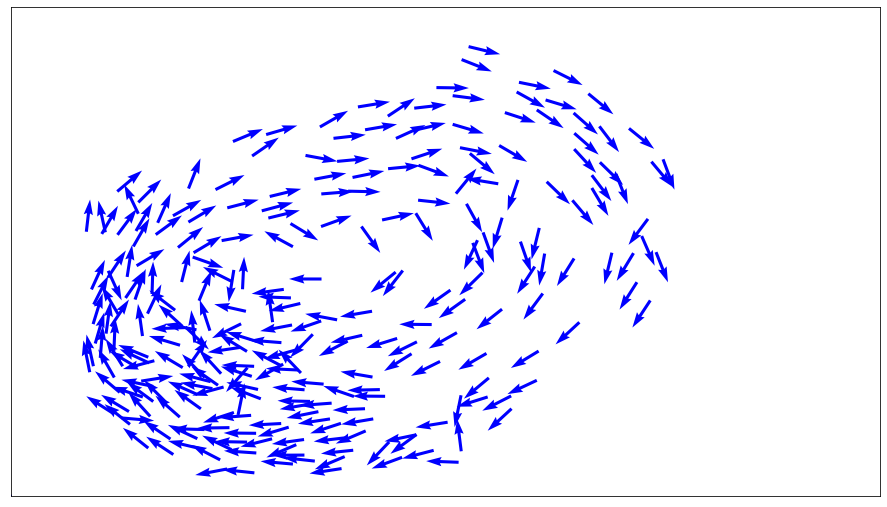

In [70]:
#
step_stride = 10
block_on_show = True

fig, axes = plt.subplots(1, 1, figsize=(16, 9))

plot_info = []
Q={}

ax_i = 1
ax = axes#[ax_i]

bounds = [(0,1920), (0,1080)]
ax.set_xlim(bounds[0][0], bounds[0][1])
ax.set_ylim(bounds[1][0], bounds[1][1])
ax.set_xticks([])
ax.set_yticks([])
ax.set_aspect(1.)
    
X, Y = pos[0,:,0],pos[0,:,1]
U, V = vel[0,:,0],vel[0,:,1]
Q[f'{ax_i}'] = ax.quiver(X, Y, U, V, pivot='mid', color='b', units='inches')



num_steps = len(data_as_list)
#print(pos_trajectory.shape)

def update_quiver(num):

    U, V = vel[num,:,0],vel[num,:,1]
    offsets  = pos[num]
    #Q[f'{ax_i}'] = ax.quiver(X, Y, U, V, pivot='mid', color='b', units='inches')
    #offsets  = np.asarray(offsets).T
    Q[f'{ax_i}'].set_offsets(offsets)
    Q[f'{ax_i}'].set_UVC(U,V)
    return axes

anim = animation.FuncAnimation(fig, update_quiver, interval=50, frames=np.arange(0, num_steps, step_stride),blit=False)
#plt.show(block=block_on_show)
rc('animation', html='jshtml')
anim
